In [1]:
import glob
import os
import sys
import librosa
import librosa.display
import librosa.core
import math
import seaborn as sns
import numpy as np
import matplotlib
matplotlib.use('Agg')
import matplotlib.pyplot as plt
from matplotlib.pyplot import specgram
from sklearn.linear_model import LogisticRegression
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split
from scipy import signal


import IPython.display
from IPython.display import Video


import pickle
import pdb
import h5py
    
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import cm
from matplotlib.ticker import LinearLocator, FormatStrFormatter

%matplotlib inline 

plt.rcParams['figure.figsize'] = (6.0, 6.0) # set default size of plots
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'Blues'

%load_ext autoreload
%autoreload 2

sns.set()
plt.rcParams.update({'font.family':'Times New Roman'})


In [2]:
#============= import for DL audio ============
import matplotlib.pyplot as plt
from scipy.io import wavfile
import argparse
import os
from glob import glob
import numpy as np
import pandas as pd
from librosa.core import resample, to_mono
from tqdm import tqdm

#Import required modules
from sklearn.decomposition import PCA
 

In [3]:
#=========== train data ===========
# filename_leaf2 = '/home/marklee/IAM/vibration_project/outdoor_test_111021/leaf/leaf21_slow.wav'
# filename_leaf3 = '/home/marklee/IAM/vibration_project/outdoor_test_111021/leaf/leaf31_s.wav'
# filename_leaf4 = '/home/marklee/IAM/vibration_project/outdoor_test_111021/leaf/leaf12_fast.wav'
# filename_leaf5 = '/home/marklee/IAM/vibration_project/outdoor_test_111021/leaf/leaf22_fast.wav'
# filename_leaf6 = '/home/marklee/IAM/vibration_project/outdoor_test_111021/leaf/leaf32_f.wav'

filename_leaf11 = '/home/marklee/IAM/vibration_project/outdoor_test_02232022/data/leaf1.wav'
filename_leaf12 = '/home/marklee/IAM/vibration_project/outdoor_test_02232022/data/leaf2.wav'
filename_leaf13 = '/home/marklee/IAM/vibration_project/outdoor_test_02232022/data/leaf3.wav'

#=============    
# filename_twig1 = '/home/marklee/IAM/vibration_project/outdoor_test_111021/twig/twig1_s.wav'
# filename_twig2 = '/home/marklee/IAM/vibration_project/outdoor_test_111021/twig/twig12_s.wav'
# filename_twig3 = '/home/marklee/IAM/vibration_project/outdoor_test_111021/twig/twig22_s.wav'

filename_twig11 = '/home/marklee/IAM/vibration_project/outdoor_test_02232022/data/twig1.wav'
filename_twig12 = '/home/marklee/IAM/vibration_project/outdoor_test_02232022/data/twig2.wav'
filename_twig13 = '/home/marklee/IAM/vibration_project/outdoor_test_02232022/data/twig3.wav'
filename_twig14 = '/home/marklee/IAM/vibration_project/outdoor_test_02232022/data/twig4.wav'
filename_twig15 = '/home/marklee/IAM/vibration_project/outdoor_test_02232022/data/twig5.wav'

filename_twig22 = '/home/marklee/IAM/vibration_project/outdoor_test_02232022/data/twig2n.wav'
filename_twig23 = '/home/marklee/IAM/vibration_project/outdoor_test_02232022/data/twig3n.wav'
filename_twig24 = '/home/marklee/IAM/vibration_project/outdoor_test_02232022/data/twig4n.wav'
filename_twig25 = '/home/marklee/IAM/vibration_project/outdoor_test_02232022/data/twig5n.wav'
#=============
# filename_trunk1 = '/home/marklee/IAM/vibration_project/outdoor_test_111021/trunk/hard1.wav'
# filename_trunk2 = '/home/marklee/IAM/vibration_project/outdoor_test_111021/trunk/hard.wav'

filename_trunk11 = '/home/marklee/IAM/vibration_project/outdoor_test_02232022/data/trunk1.wav'
filename_trunk12 = '/home/marklee/IAM/vibration_project/outdoor_test_02232022/data/trunk2.wav'
filename_trunk13 = '/home/marklee/IAM/vibration_project/outdoor_test_02232022/data/trunk3.wav'
filename_trunk14 = '/home/marklee/IAM/vibration_project/outdoor_test_02232022/data/trunk4.wav'

filename_trunk22 = '/home/marklee/IAM/vibration_project/outdoor_test_02232022/data/trunk2n.wav'
filename_trunk23 = '/home/marklee/IAM/vibration_project/outdoor_test_02232022/data/trunk3n.wav'
filename_trunk24 = '/home/marklee/IAM/vibration_project/outdoor_test_02232022/data/trunk4n.wav'
filename_trunk25 = '/home/marklee/IAM/vibration_project/outdoor_test_02232022/data/trunk5n.wav'
#=============

input_leaf_list = [filename_leaf11, filename_leaf12, filename_leaf13]
input_twig_list = [filename_twig11, filename_twig12, filename_twig13, filename_twig14, filename_twig15, filename_twig22, filename_twig23, filename_twig24, filename_twig25]
input_trunk_list = [filename_trunk11, filename_trunk12, filename_trunk13, filename_trunk14, filename_trunk22, filename_trunk23, filename_trunk24, filename_trunk25]

In [4]:
#=========== test data ===========
filename_leaf1 = '/home/marklee/IAM/vibration_project/outdoor_test_02232022/data/leaf1.wav'
filename_twig21 = '/home/marklee/IAM/vibration_project/outdoor_test_02232022/data/twig1n.wav'
filename_trunk21 = '/home/marklee/IAM/vibration_project/outdoor_test_02232022/data/trunk1n.wav'

test_leaf_list = [filename_leaf1]
test_twig_list = [filename_twig21]
test_trunk_list = [filename_trunk21]

In [4]:
def load_audio_from_name(input_list, audio_channel):
    
    audio_list = []
    total_audio = np.array([])
    
    #load
    for file_name in (input_list):
        audio_input, fs = librosa.load(file_name, mono=False)
        audio_list.append(audio_input[audio_channel]) #just get 1st audio channel

    #concat into 1 audio file
    for audio_list in (audio_list):
        total_audio = np.concatenate((total_audio, audio_list))
#         print(f"{total_audio.shape}")
        
    
#     return audio_list
    return total_audio, fs


In [5]:
audio_channel = 0
audio_leaf_total, fs = load_audio_from_name(input_leaf_list, audio_channel)
audio_twig_total, fs = load_audio_from_name(input_twig_list, audio_channel)
audio_trunk_total, fs = load_audio_from_name(input_trunk_list, audio_channel)


In [7]:
#=========== test data ===========
audio_channel = 0
t_audio_leaf_total, fs = load_audio_from_name(test_leaf_list, audio_channel)
t_audio_twig_total, fs = load_audio_from_name(test_twig_list, audio_channel)
t_audio_trunk_total, fs = load_audio_from_name(test_trunk_list, audio_channel)


In [6]:
print(f"leaf: {audio_leaf_total.shape}, twig: {audio_twig_total.shape}, trunk: {audio_trunk_total.shape}")

leaf: (858587,), twig: (5698241,), trunk: (3566644,)


In [7]:
(3566644+858587+5698241)/fs

459.1143764172336

In [9]:
print(f"leaf: {t_audio_leaf_total.shape}, twig: {t_audio_twig_total.shape}, trunk: {t_audio_trunk_total.shape}")

leaf: (285240,), twig: (464259,), trunk: (366189,)


In [10]:
IPython.display.Audio(audio_leaf_total, rate=fs)

In [11]:
IPython.display.Audio(audio_twig_total, rate=fs)

In [12]:
IPython.display.Audio(audio_trunk_total, rate=fs)

In [13]:
%matplotlib inline

No handles with labels found to put in legend.


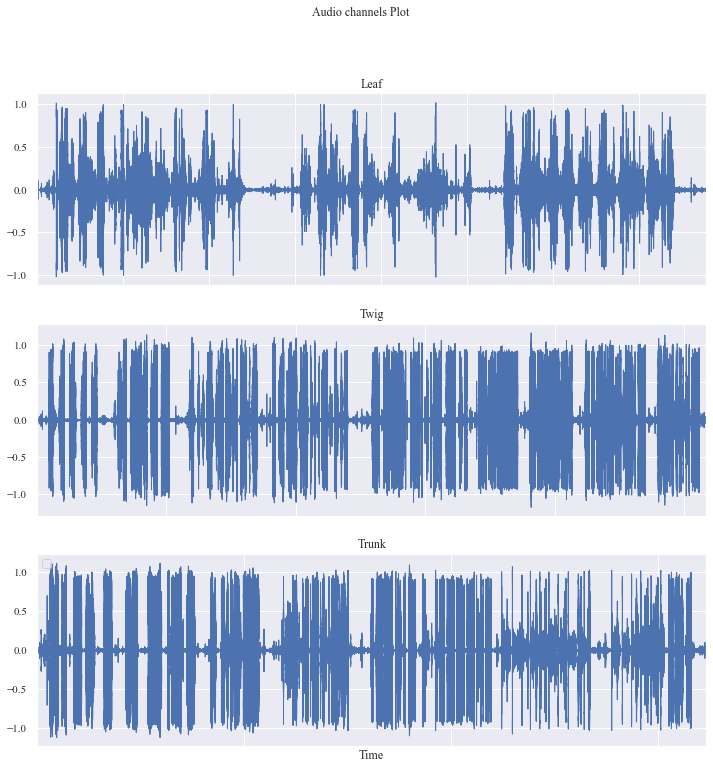

In [14]:
    
fig = plt.figure(figsize=(12,12))
fig.suptitle('Audio channels Plot')

ax1 = plt.subplot(3,1,1)
librosa.display.waveplot(audio_leaf_total,sr=fs)
plt.title("Leaf")
plt.setp( ax1.get_xticklabels(), visible=False)
ax1.xaxis.set_label_text('')

ax2 = plt.subplot(3,1,2)
librosa.display.waveplot(audio_twig_total, sr=fs)
plt.title("Twig")
plt.setp( ax2.get_xticklabels(), visible=False)
ax2.xaxis.set_label_text('')

ax3 = plt.subplot(3,1,3)
librosa.display.waveplot(audio_trunk_total, sr=fs)
plt.title("Trunk")
plt.setp( ax3.get_xticklabels(), visible=False)
ax3.xaxis.set_label_text('')


plt.legend(loc=2)
ax3.set_xlabel("Time")
plt.show()


In [15]:
def envelope(y, rate, threshold):
#     print("received y:", y.shape)
#     print("y", y)
    mask = []
    y = pd.Series(y).apply(np.abs)
#     print("y after series:", y.shape)
    y_mean = y.rolling(window=int(rate/20),
                       min_periods=1,
                       center=True).max()
#     print("y_mean:", y_mean.shape)
    
    for mean in y_mean:
        if mean > threshold:
            mask.append(True)
        else:
            mask.append(False)
    return mask, y_mean

In [16]:
#=========== test data ===========
threshold_leaf = 0.035
threshold_twig = 0.05
threshold_trunk = 0.2

t_mask_leaf, envelop = envelope(t_audio_twig_total, fs, threshold=threshold_leaf)
t_audio_threshold_leaf =  t_audio_twig_total[t_mask_leaf]

t_mask_twig, envelop = envelope(t_audio_twig_total, fs, threshold=threshold_twig)
t_audio_threshold_twig =  t_audio_twig_total[t_mask_twig]

t_mask_trunk, envelop = envelope(t_audio_trunk_total, fs, threshold=threshold_trunk)
t_audio_threshold_trunk =  t_audio_trunk_total[t_mask_trunk]

In [17]:

threshold_leaf = 0.035
threshold_twig = 0.05
threshold_trunk = 0.2

mask_leaf, envelop = envelope(audio_leaf_total, fs, threshold=threshold_leaf)
audio_threshold_leaf =  audio_leaf_total[mask_leaf]

mask_twig, envelop = envelope(audio_twig_total, fs, threshold=threshold_twig)
audio_threshold_twig =  audio_twig_total[mask_twig]

mask_trunk, envelop = envelope(audio_trunk_total, fs, threshold=threshold_trunk)
audio_threshold_trunk =  audio_trunk_total[mask_trunk]

No handles with labels found to put in legend.


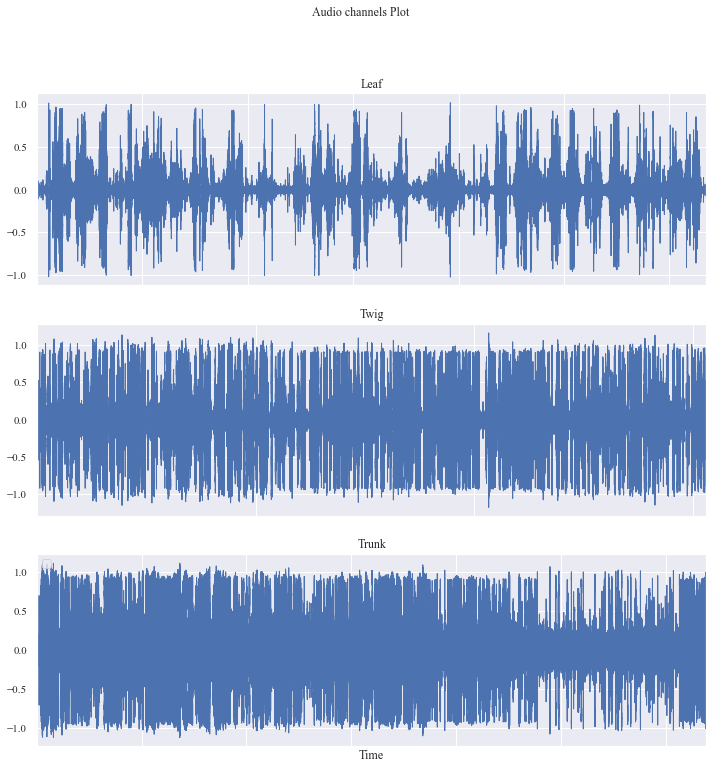

In [18]:
    
fig = plt.figure(figsize=(12,12))
fig.suptitle('Audio channels Plot')

ax1 = plt.subplot(3,1,1)
librosa.display.waveplot(audio_threshold_leaf,sr=fs)
plt.title("Leaf")
plt.setp( ax1.get_xticklabels(), visible=False)
ax1.xaxis.set_label_text('')

ax2 = plt.subplot(3,1,2)
librosa.display.waveplot(audio_threshold_twig, sr=fs)
plt.title("Twig")
plt.setp( ax2.get_xticklabels(), visible=False)
ax2.xaxis.set_label_text('')

ax3 = plt.subplot(3,1,3)
librosa.display.waveplot(audio_threshold_trunk, sr=fs)
plt.title("Trunk")
plt.setp( ax3.get_xticklabels(), visible=False)
ax3.xaxis.set_label_text('')


plt.legend(loc=2)
ax3.set_xlabel("Time")
plt.show()


In [19]:
print(f"len {audio_threshold_leaf.shape}, {audio_threshold_twig.shape},{audio_threshold_trunk.shape}")

len (700052,), (3373524,),(1408124,)


In [20]:
IPython.display.Audio(audio_threshold_leaf, rate=fs)

In [21]:
IPython.display.Audio(audio_threshold_twig, rate=fs)

In [22]:
IPython.display.Audio(audio_threshold_trunk, rate=fs)

In [23]:
print(f"{audio_threshold_trunk.shape}, {audio_threshold_twig.shape},{audio_threshold_leaf.shape},")

(1408124,), (3373524,),(700052,),


In [24]:
#============ trim to same length ================
min_length = np.min((len(audio_threshold_leaf),len(audio_threshold_twig),len(audio_threshold_trunk)))

start = 5*fs
end = 10*fs

audio_threshold_leaf_same = audio_threshold_leaf[start:end] #start:end
audio_threshold_twig_same = audio_threshold_twig[start:end]
audio_threshold_trunk_same = audio_threshold_trunk[start:end] #0:min_length
min_length


700052

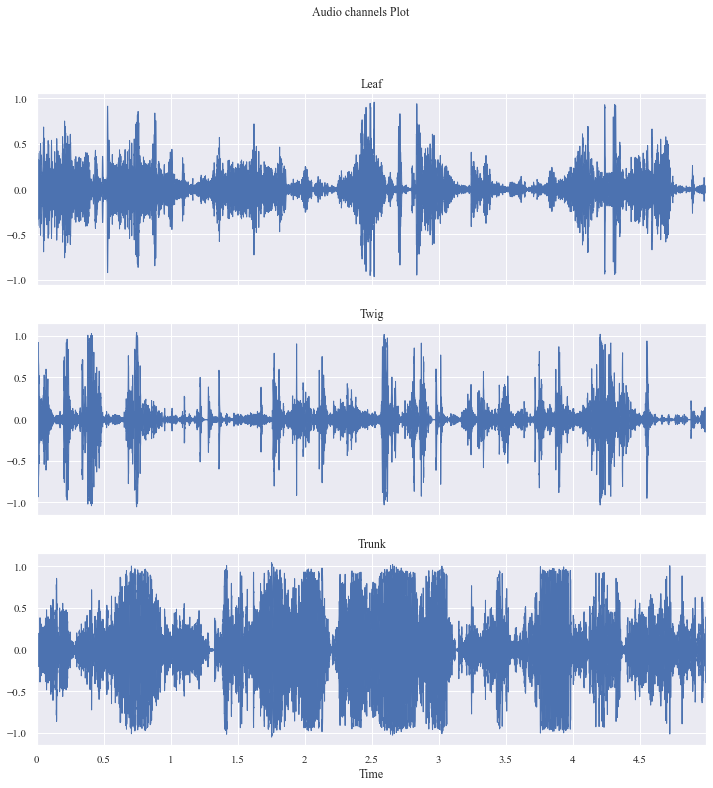

In [25]:
    
fig = plt.figure(figsize=(12,12))
fig.suptitle('Audio channels Plot')

ax1 = plt.subplot(3,1,1)
librosa.display.waveplot(audio_threshold_leaf_same,sr=fs)
plt.title("Leaf")
plt.setp( ax1.get_xticklabels(), visible=False)
ax1.xaxis.set_label_text('')

ax2 = plt.subplot(3,1,2)
librosa.display.waveplot(audio_threshold_twig_same, sr=fs)
plt.title("Twig")
plt.setp( ax2.get_xticklabels(), visible=False)
ax2.xaxis.set_label_text('')

ax3 = plt.subplot(3,1,3)
librosa.display.waveplot(audio_threshold_trunk_same, sr=fs)
plt.title("Trunk")
plt.setp( ax3.get_xticklabels(), visible=True)
ax3.xaxis.set_label_text('')


ax3.set_xlabel("Time")
plt.show()


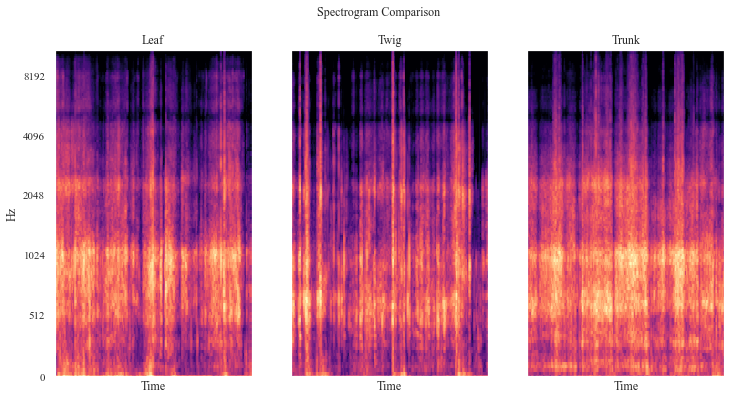

In [26]:
n_fft = 2048 #standard for audio (speech is 512)
hop_length = 512 #n_fft / 4
n_mels = 128
mel = librosa.filters.mel(sr=fs, n_fft=n_fft, n_mels=n_mels)

fig = plt.figure(figsize=(12,6))
fig.suptitle('Spectrogram Comparison')

ax1 = plt.subplot(1,3,1)
S_leaf = librosa.feature.melspectrogram(audio_threshold_leaf_same, sr=fs, n_fft=n_fft, hop_length=hop_length, n_mels=n_mels)
S_DB_leaf = librosa.power_to_db(S_leaf, ref=np.max)
img_plot = librosa.display.specshow(S_DB_leaf, sr=fs, hop_length=hop_length, x_axis='time', y_axis='mel');

plt.title("Leaf")
plt.setp( ax1.get_xticklabels(), visible=False)
ax1.xaxis.set_label_text('')
ax1.set_xlabel("Time")

ax2 = plt.subplot(1,3,2)
S_twig = librosa.feature.melspectrogram(audio_threshold_twig_same, sr=fs, n_fft=n_fft, hop_length=hop_length, n_mels=n_mels)
S_DB_twig = librosa.power_to_db(S_twig, ref=np.max)
librosa.display.specshow(S_DB_twig, sr=fs, hop_length=hop_length, x_axis='time', y_axis='mel');

plt.title("Twig")
plt.setp( ax2.get_xticklabels(), visible=False)
plt.setp( ax2.get_yticklabels(), visible=False)
ax2.xaxis.set_label_text('')
ax2.yaxis.set_label_text('')
ax2.set_xlabel("Time")

ax3 = plt.subplot(1,3,3)
S_trunk = librosa.feature.melspectrogram(audio_threshold_trunk_same, sr=fs, n_fft=n_fft, hop_length=hop_length, n_mels=n_mels)
S_DB_trunk = librosa.power_to_db(S_trunk, ref=np.max)
librosa.display.specshow(S_DB_trunk, sr=fs, hop_length=hop_length, x_axis='time', y_axis='mel');

plt.title("Trunk")
plt.setp( ax3.get_xticklabels(), visible=False)
plt.setp( ax3.get_yticklabels(), visible=False)
ax3.xaxis.set_label_text('')
ax3.yaxis.set_label_text('')
ax3.set_xlabel("Time")

plt.show()




In [27]:
def augment_audio(audio_in, label, duration, stride):
    X_list = []
    y_list = []
    
    L = len(audio_in)

    data_count = np.ceil((L - duration + 1)/stride).astype(int)
    
    for i in range (data_count):
        audio_slice = audio_in[i*stride:i*stride+duration]
        X_list.append(audio_slice)
        y_list.append(int(label))
    
    X_np = np.array(X_list)
    y_np = np.array(y_list)

    return X_np, y_np, data_count

In [28]:
sample_duration = int(fs/1) #1 sec duration samples
stride_length = int(fs/10) #100 msec stride between samples

label = {
    "leaf" : 1,
    "twig" : 2,
    "trunk": 3
}

In [29]:
#===== augment time audio data ======
audio_leaf_data, _, count = augment_audio(audio_threshold_leaf,label['leaf'],sample_duration,stride_length)
audio_twig_data, _, count = augment_audio(audio_threshold_twig,label['twig'],sample_duration,stride_length)
audio_trunk_data, _, count = augment_audio(audio_threshold_trunk,label['trunk'],sample_duration,stride_length)

In [30]:
#=========== test data ===========
t_audio_leaf_data, _, count = augment_audio(t_audio_threshold_leaf,label['leaf'],sample_duration,stride_length)
t_audio_twig_data, _, count = augment_audio(t_audio_threshold_twig,label['twig'],sample_duration,stride_length)
t_audio_trunk_data, _, count = augment_audio(t_audio_threshold_trunk,label['trunk'],sample_duration,stride_length)

In [31]:
print(f"leaf: {audio_leaf_data.shape}, twig: {audio_twig_data.shape}, trunk: {audio_trunk_data.shape}")

leaf: (308, 22050), twig: (1520, 22050), trunk: (629, 22050)


In [32]:
#============ trim to same length ================
min_length = np.min([audio_leaf_data.shape[0],audio_twig_data.shape[0],audio_trunk_data.shape[0]])
audio_leaf_data = audio_leaf_data[0:min_length,:]
audio_twig_data = audio_twig_data[0:min_length,:]
audio_trunk_data = audio_trunk_data[0:min_length,:]
min_length

308

In [33]:
print(f"leaf: {t_audio_leaf_data.shape}, twig: {t_audio_twig_data.shape}, trunk: {t_audio_trunk_data.shape}")

leaf: (150, 22050), twig: (136, 22050), trunk: (54, 22050)


In [34]:
#============ trim to same length ================
t_min_length = np.min([t_audio_leaf_data.shape[0],t_audio_twig_data.shape[0],t_audio_trunk_data.shape[0]])
t_audio_leaf_data = t_audio_leaf_data[0:t_min_length,:]
t_audio_twig_data = t_audio_twig_data[0:t_min_length,:]
t_audio_trunk_data = t_audio_trunk_data[0:t_min_length,:]


In [35]:
def convert_audio_data_to_spec(audio_data_table_, label):
    
    spectrogram_list = []
    y_list = []
    num, sample_length_ = audio_data_table_.shape
    
    # convert audio data to spectrogram data
    n_fft = 2048 #standard for audio (speech is 512)
    hop_length = 512 #n_fft / 4
    n_mels = 128
    mel = librosa.filters.mel(sr=fs, n_fft=n_fft, n_mels=n_mels)

    for i in range (num):
        
        S_ = librosa.feature.melspectrogram(audio_data_table_[i,:], sr=fs, n_fft=n_fft, hop_length=hop_length, n_mels=n_mels)
        S_DB_ = librosa.power_to_db(S_, ref=np.max)
        
        #mean across time
        S_DB_flat = np.mean((S_DB_),axis=1) 
        
        spectrogram_list.append(S_DB_flat)
        y_list.append(int(label))
        
    X_spec = np.array(spectrogram_list)
    y_spec = np.array(y_list)
    
    return X_spec,y_spec, num
    

In [36]:
#convert audio to spectrogram
X_spec_leaf, y_spec_leaf, leaf_count = convert_audio_data_to_spec(audio_leaf_data, label['leaf'])
X_spec_twig, y_spec_twig, twig_count = convert_audio_data_to_spec(audio_twig_data, label['twig'])
X_spec_trunk, y_spec_trunk, leaf_trunk = convert_audio_data_to_spec(audio_trunk_data, label['trunk'])

In [37]:
#=========== test data ===========
t_X_spec_leaf, t_y_spec_leaf, leaf_count = convert_audio_data_to_spec(t_audio_leaf_data, label['leaf'])
t_X_spec_twig, t_y_spec_twig, twig_count = convert_audio_data_to_spec(t_audio_twig_data, label['twig'])
t_X_spec_trunk, t_y_spec_trunk, leaf_trunk = convert_audio_data_to_spec(t_audio_trunk_data, label['trunk'])

In [38]:
print(f"{X_spec_leaf.shape}, {X_spec_twig.shape}, {X_spec_trunk.shape}")

(308, 128), (308, 128), (308, 128)


In [39]:
#combine all data X
S_DB_table1 = np.concatenate((X_spec_leaf, X_spec_twig, X_spec_trunk),axis=0)
scatter_color = np.concatenate((y_spec_leaf, y_spec_twig, y_spec_trunk), axis=0)

#print out data table shape
print(f"shape {S_DB_table1.shape}, {scatter_color.shape}") #num items x flattened features


shape (924, 128), (924,)


In [40]:
#========= test ==========
t_S_DB_table1 = np.concatenate((t_X_spec_leaf, t_X_spec_twig, t_X_spec_trunk),axis=0)
t_scatter_color = np.concatenate((t_y_spec_leaf, t_y_spec_twig, t_y_spec_trunk), axis=0)
print(f"shape {t_S_DB_table1.shape}, {t_scatter_color.shape}") #num items x flattened features


shape (162, 128), (162,)


In [41]:
#normalize before doing PCA
from sklearn.preprocessing import StandardScaler
S_DB_table1_norm = StandardScaler().fit_transform(S_DB_table1)



In [42]:
# S_DB_table1_norm[:,0].shape
np.var(S_DB_table1_norm[:,0])

0.9999999999999993

In [43]:
#how many PCA components?
pca = PCA()
S_DB_table_pca = pca.fit_transform(S_DB_table1_norm) 
# S_DB_table_pca = pca.fit_transform(S_DB_table1) 

exp_var_pca = pca.explained_variance_ratio_
cum_sum_eigenvalues = np.cumsum(exp_var_pca)

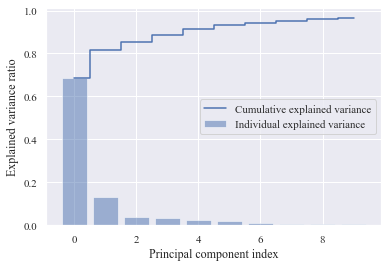

In [44]:
# Create the visualization plot
#
plt.bar(range(0,len(exp_var_pca[0:10])), exp_var_pca[0:10], alpha=0.5, align='center', label='Individual explained variance')
plt.step(range(0,len(cum_sum_eigenvalues[0:10])), cum_sum_eigenvalues[0:10], where='mid',label='Cumulative explained variance')
plt.ylabel('Explained variance ratio')
plt.xlabel('Principal component index')
plt.legend(loc='best')
plt.show()


In [90]:
%matplotlib inline

In [82]:
exp_var_pca[0:3]

array([0.68709988, 0.12998092, 0.0376735 ])

In [45]:
#reduce dim with PCA
pca = PCA(3) # we need 2 principal components.
S_DB_table_pca1 = pca.fit_transform(S_DB_table1_norm)
#print out data table shape
print(f"pca shape {S_DB_table_pca1.shape}")

pca shape (924, 3)


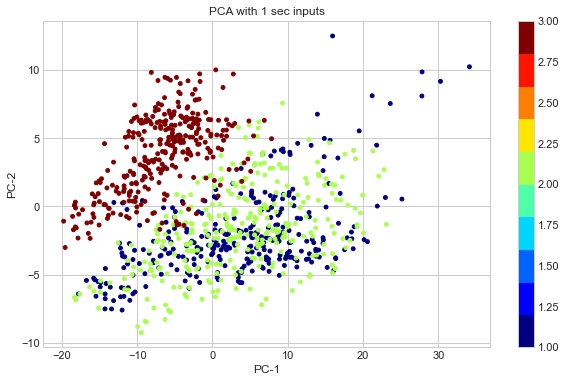

In [46]:
#scatter plot
plt.style.use('seaborn-whitegrid')
plt.figure(figsize = (10,6))
c_map = plt.cm.get_cmap('jet', 10)
plt.scatter(S_DB_table_pca1[:, 0], S_DB_table_pca1[:, 1], s = 15,
            cmap = c_map , c = scatter_color)

plt.xlabel('PC-1') , plt.ylabel('PC-2')
plt.title("PCA with 1 sec inputs")

plt.colorbar()
plt.show()

In [47]:
%matplotlib widget

In [102]:
%matplotlib inline

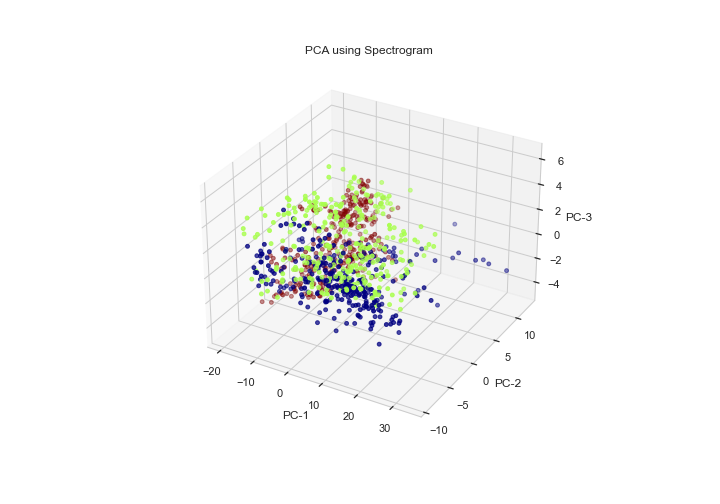

In [48]:
# Creating figure
fig = plt.figure(figsize = (10, 7))
ax = plt.axes(projection ="3d")
 
# Creating plot
ax.scatter3D(S_DB_table_pca1[:, 0], S_DB_table_pca1[:, 1], S_DB_table_pca1[:, 2], s = 15,
            cmap = c_map , c = scatter_color)
plt.title("PCA using Spectrogram")

ax.set_xlabel('PC-1')
ax.set_ylabel('PC-2')
ax.set_zlabel('PC-3')
    
# show plot
plt.show()

In [49]:
#visualize eigenfaces
print(f"eigenVect size: {pca.components_.shape}") #eigen vectors
print(f"eigen val: {pca.explained_variance_.shape}") #eigen values

eigenvector_np = np.concatenate((pca.components_[0].reshape(128,1), pca.components_[1].reshape(128,1), pca.components_[2].reshape(128,1)), axis=1)
eigenvector_np.shape

eigenVect size: (3, 128)
eigen val: (3,)


(128, 3)

In [50]:
(pca.explained_variance_[0])

2188.277740498842

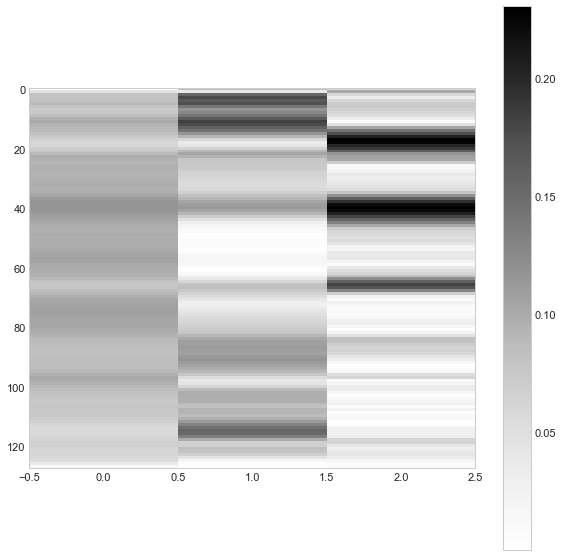

In [54]:
# Creating figure
plt.figure(figsize = (10,10))

plt.imshow(np.abs(eigenvector_np), interpolation='nearest', aspect=0.02)
plt.colorbar()
plt.grid(None) 
plt.show()

In [107]:
np.argsort(np.abs(eigenvector_np[:,0]))
#74, 50

array([  0,   1, 127, 126,   2, 115,   3, 116,  18,   5, 114,   4,  17,
        19,   6,   8,  16, 125,   7, 117,  20,   9,  13,  10,  12,  11,
        21,  14,  15, 113, 124,  22,  66, 123, 122, 118,  67, 112,  40,
       121,  23,  41,  39,  65,  24,  25,  42,  38, 111,  68,  37, 120,
        64,  43, 119,  26,  88,  36,  87,  90,  89, 110,  91, 109,  85,
        44,  63,  35, 105,  86,  84, 104,  92,  34,  93, 103,  33,  62,
        27, 108,  61, 102,  31,  32, 106,  69,  94,  45,  60,  29,  30,
       101,  97,  28,  70,  83, 107,  95,  71,  96, 100,  98,  46,  59,
        99,  47,  72,  58,  82,  57,  55,  56,  81,  48,  80,  79,  49,
        54,  78,  51,  53,  73,  52,  50,  75,  76,  77,  74])

In [113]:
#visualize eigenfaces
print(f"eigenVect size: {pca.components_.shape}") #eigen vectors
print(f"eigen val: {pca.explained_variance_.shape}") #eigen values

pca1 = pca.components_[0]*1.5
eigenvector_np = np.concatenate((pca1.reshape(128,1), pca.components_[1].reshape(128,1), pca.components_[2].reshape(128,1)), axis=1)
eigenvector_np.shape

eigenVect size: (128, 128)
eigen val: (128,)


(128, 3)

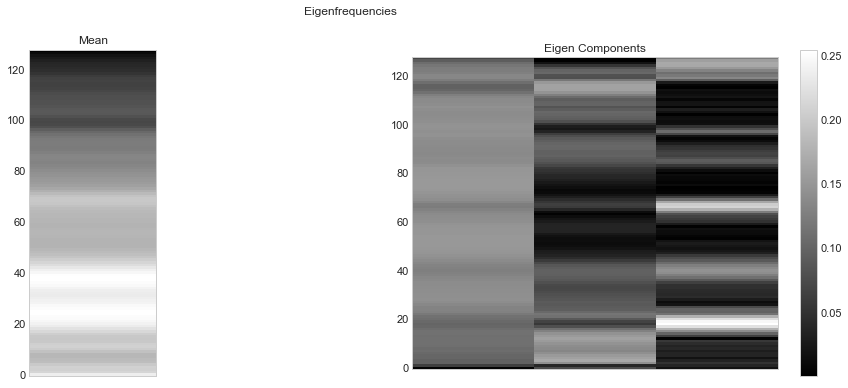

In [114]:
#============= eigenfreq mean and var ===============
#show mean of all data points
mean_data = np.sum((S_DB_table1),axis=0) /S_DB_table1.shape[0]
mean_data.shape

fig = plt.figure(figsize=(18,6))
fig.suptitle('Eigenfrequencies')

ax1 = plt.subplot(1,2,1)

plt.imshow(mean_data.reshape(128,1), interpolation='nearest', aspect=0.02, origin='lower', cmap = 'gray')
# plt.colorbar()
plt.grid(None) 
plt.title("Mean")
plt.setp( ax1.get_xticklabels(), visible=False)
ax1.xaxis.set_label_text('')


ax2 = plt.subplot(1,2,2)
plt.imshow(np.abs(eigenvector_np), interpolation='nearest', aspect=0.02, origin='lower', cmap='gray')
plt.grid(None) 
plt.title("Eigen Components")
plt.setp( ax2.get_xticklabels(), visible=False)
ax2.xaxis.set_label_text('')
plt.colorbar()


plt.show()


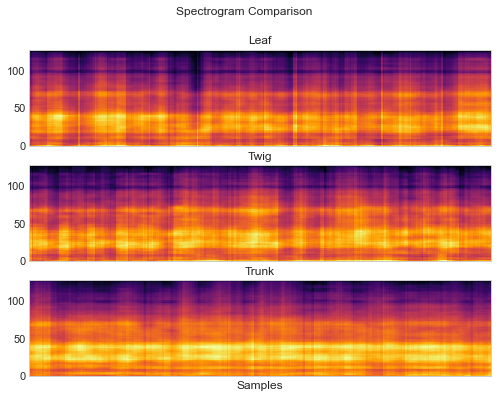

In [117]:
#============= plot bands of flattened (meaned) spectrogram across 3 class ===============
aspect = 0.5
fig = plt.figure(figsize=(18,6))
fig.suptitle('Spectrogram Comparison')

ax1 = plt.subplot(3,1,1)

plt.imshow(X_spec_leaf[0:X_spec_trunk.shape[0],:].T, cmap='inferno', interpolation='nearest', origin='lower', aspect=aspect)
plt.grid(False)
plt.title("Leaf")
plt.setp( ax1.get_xticklabels(), visible=False)
ax1.xaxis.set_label_text('')


ax2 = plt.subplot(3,1,2)
plt.imshow(X_spec_twig[0:X_spec_trunk.shape[0],:].T, cmap='inferno', interpolation='nearest', origin='lower', aspect=aspect)
plt.grid(False)
plt.title("Twig")
plt.setp( ax2.get_xticklabels(), visible=False)
ax2.xaxis.set_label_text('')


ax3 = plt.subplot(3,1,3)

plt.imshow(X_spec_trunk[0:X_spec_trunk.shape[0],:].T, cmap='inferno', interpolation='nearest', origin='lower', aspect=aspect)
plt.grid(False)
plt.title("Trunk")
plt.setp( ax3.get_xticklabels(), visible=False)
ax3.xaxis.set_label_text('')
ax3.set_xlabel("Samples")

plt.show()


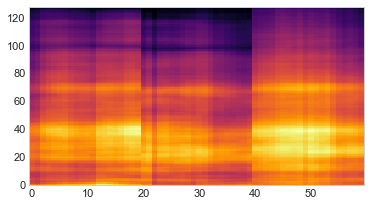

In [121]:
#verify scales are consistent by concat
N = 20
total_spec = np.concatenate((X_spec_leaf[0:N,:].T, X_spec_twig[0:N,:].T ,X_spec_trunk[0:N,:].T),axis=1)
plt.imshow(total_spec, cmap='inferno', interpolation='nearest', origin='lower', aspect=.25)
plt.grid(False)


In [122]:
#print out data table shape
print(f"shape {S_DB_table1.shape}, {scatter_color.shape}") #num items x flattened features
data_XY = np.hstack((S_DB_table1,scatter_color.reshape(len(scatter_color),1)))
print(data_XY.shape)

shape (924, 128), (924,)
(924, 129)


In [123]:
df = pd.DataFrame(data = data_XY)

In [124]:
df[128].value_counts()

3.0    308
2.0    308
1.0    308
Name: 128, dtype: int64

In [125]:
from sklearn.model_selection import train_test_split

In [126]:
X = S_DB_table1
y = scatter_color
y_text = y.astype(str)

In [127]:
# y_text[y_text=='1'] = 'leaf'
# y_text[y_text=='2'] = 'twig'
# y_text[y_text=='3'] = 'trunk'

In [128]:
#============= test=================
test_y_txt = t_scatter_color.astype(str)
test_y_txt[test_y_txt=='1'] = 'leaf'
test_y_txt[test_y_txt=='2'] = 'twig'
test_y_txt[test_y_txt=='3'] = 'trunk'

# t_S_DB_table1

In [129]:

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state=3)
print(f"X_train {X_train.shape}, X_test {X_test.shape}, y_train {y_train.shape}, y_test {y_test.shape}")

X_train (739, 128), X_test (185, 128), y_train (739,), y_test (185,)


In [146]:
from sklearn import svm, metrics
from sklearn.metrics import ConfusionMatrixDisplay

#create classifier Support Vector Classifier
clf = svm.SVC()

#learn to fit
clf.fit(X_train,y_train)

#predict based on model
predicted = clf.predict(X_test)



In [147]:
print(
    f"Classification report for classifier {clf}:\n"
    f"{metrics.classification_report(y_test, predicted)}\n"
)

Classification report for classifier SVC():
              precision    recall  f1-score   support

           1       0.95      0.95      0.95        73
           2       0.93      0.93      0.93        58
           3       1.00      1.00      1.00        54

    accuracy                           0.96       185
   macro avg       0.96      0.96      0.96       185
weighted avg       0.96      0.96      0.96       185




Confusion matrix:
[[0.94520548 0.05479452 0.        ]
 [0.06896552 0.93103448 0.        ]
 [0.         0.         1.        ]]


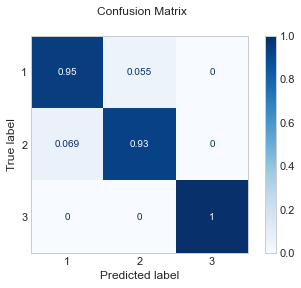

In [148]:
disp = ConfusionMatrixDisplay.from_predictions(y_test, predicted, normalize = 'true',cmap=plt.cm.Blues)
disp.figure_.suptitle("Confusion Matrix")
print(f"Confusion matrix:\n{disp.confusion_matrix}")

plt.grid(False)
plt.show()

In [141]:
X_test.shape

(185, 128)

In [142]:
#========= test =========
# predict based on model
t_predicted = clf.predict(t_S_DB_table1)

In [143]:
print(clf)

SVC(kernel='linear')


In [144]:
print(
    f"Classification report for classifier {clf}:\n"
    f"{metrics.classification_report(t_scatter_color, t_predicted)}\n"
)

Classification report for classifier SVC(kernel='linear'):
              precision    recall  f1-score   support

           1       0.49      0.89      0.63        54
           2       0.31      0.07      0.12        54
           3       1.00      0.94      0.97        54

    accuracy                           0.64       162
   macro avg       0.60      0.64      0.57       162
weighted avg       0.60      0.64      0.57       162




Confusion matrix:
[[0.88888889 0.11111111 0.        ]
 [0.92592593 0.07407407 0.        ]
 [0.         0.05555556 0.94444444]]


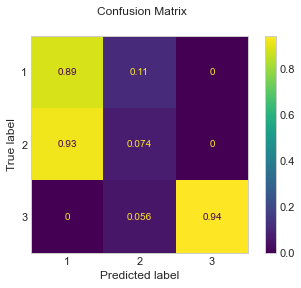

In [145]:
disp = ConfusionMatrixDisplay.from_predictions(t_scatter_color, t_predicted, normalize = 'true')
disp.figure_.suptitle("Confusion Matrix")
print(f"Confusion matrix:\n{disp.confusion_matrix}")
plt.grid(False)
plt.show()



In [74]:
%matplotlib inline